What this notebook does:

Computes coffee shop averages for the 5 topic LDA importance vectors. 

Visualizes the distribution of the shop-specific averages. Verifies that topic importances align with Yelp categories

Visualizes the geographic distribution of topic importances for different shops




In [ ]:
#Step one directory up to access the yelp scraping function in the helper_functions module
import os
print(os.getcwd())
os.chdir('../')
os.getcwd()

In [5]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt

import numpy as np

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import descartes

#For creating interactive maps
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

#Let's look at the distribution of the coffee shops on a map
# import libraries
import geopandas as gpd
from shapely.geometry import Point, Polygon
import matplotlib.pyplot as plt

import branca

topiclabels = ['Coffee','Setting','Service','Food','Sweets']


In [8]:
shops = pd.read_csv('./ProcessedData/coffeeshops_withcfcutoff.csv')
reviews = pd.read_csv('./LDAresults/ldatopicweights_allreviews_5topics.csv')
merged = pd.merge(shops,reviews,how='inner',on = ['alias'])
merged.shape

(42644, 32)

Now looking at the geographic distribution of reviews topics
I first take the mean of the review topic vectors for each coffeeshop
For each topic, I plot its average review importance for various shops on a map

In [9]:
#Calculating mean and sems of topic importances

avgtopicbyalias = merged.groupby('alias')[['t0','t1','t2','t3','t4']].mean()
avgtopicbyalias.reset_index()
avgtopicbyalias = pd.merge(avgtopicbyalias,shops,how='inner',on = ['alias'])

sdtopicbyalias = merged.groupby('alias')[['t0','t1','t2','t3','t4']].std()
sdtopicbyalias.reset_index()
avgtopicbyalias = pd.merge(avgtopicbyalias,sdtopicbyalias, how='inner',on=['alias'],suffixes = ('_mean','_std'))

for i in range(0,5):
    avgtopicbyalias['t' + str(i) + '_sem'] = avgtopicbyalias['t' + str(i) + '_std']/np.sqrt(avgtopicbyalias.numreviews)



### Visualizing the distribution of LDA-topic averages for individual shops

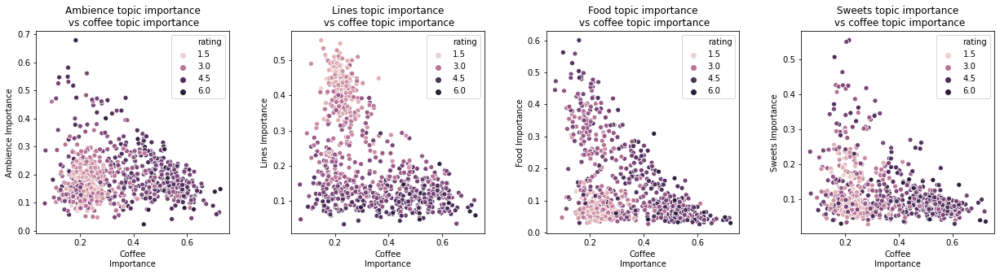

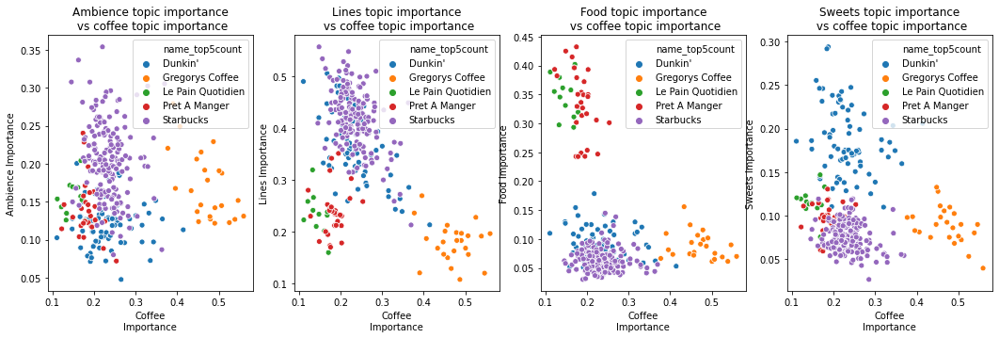

In [10]:

fig,ax = plt.subplots(1,4,figsize=(18,5))
fig.tight_layout(pad = 4.5)

for i in [1,2,3,4]:
    sns.scatterplot(x = "t0_mean",y='t'+str(i)+'_mean',hue='rating',data=avgtopicbyalias,ax=ax[i-1])
    ax[i-1].set_title(topiclabels[i] + ' topic importance\n vs coffee topic importance' )
    ax[i-1].set_ylabel(topiclabels[i] + ' Importance')
    ax[i-1].set_xlabel('Coffee\nImportance')

#Now plotting, but colored according to identity of the shop
fig1,ax = plt.subplots(1,4,figsize=(18,5))
for i in [1,2,3,4]:
    sns.scatterplot(x = "t0_mean",y='t'+str(i)+'_mean',hue='name_top5count',
                    data=avgtopicbyalias[avgtopicbyalias.name_top5count!='other'],ax=ax[i-1],alpha=1)
    ax[i-1].set_title(topiclabels[i] + ' topic importance\n vs coffee topic importance' )
    ax[i-1].set_ylabel(topiclabels[i] + ' Importance')
    ax[i-1].set_xlabel('Coffee\nImportance')



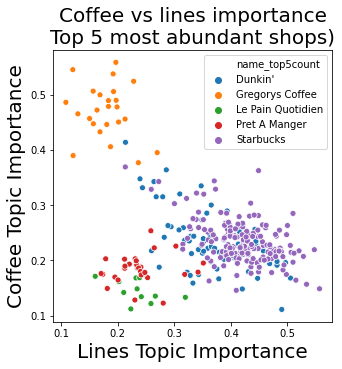

In [11]:
fig2,ax2 = plt.subplots(1,1,figsize=(5,5))
sns.scatterplot(x = "t2_mean",y="t0_mean",hue='name_top5count',data=avgtopicbyalias
                [avgtopicbyalias.name_top5count!='other'],ax=ax2,alpha=1)
ax2.set_title('Coffee vs lines importance\nTop 5 most abundant shops)',fontsize=20)
ax2.set_xlabel('Lines Topic Importance',fontsize=20)
ax2.set_ylabel('Coffee Topic Importance',fontsize=20)
fig2.savefig('./Figures/coffeevslines_top5.png',bbox_inches='tight')

Plotting the avg topic scores against avg coffee topic scores shows some clustering.  There is a clear distinction between with a strong coffee topic component (>0.3) and week coffee component shops (<0.3 on average).  A strong lines/wait component corresponds to lower ratings. By this definition coffee shops with a strong lines component have weak components for the remaining topics. 

In summary, there are 2 populations of coffee shops - one with a strong coffee component (>0.3), one with a weak coffee component and strong lines component, and one with a weak coffee component and weak lines component. A stronger food or dessert component typically corresponds to higher ratings for restaurants with a weak coffee component (more so than the tables component)

Above, we look at what coffee shops correspond to the different dimensions. For the most part, the lines topic is only strong for starbucks and dunkin donuts. Coffee shops for the largest company tend to be more similar to one another. A lot of variability in the data set is explained by what the companies are offering themselves.

### Distribution of the standard error of the mean for the averages of topic importance for each shop

The sems of the show aggregated mean lda topic scores are for the most part less than 0.06. A 95% confidence interval, assuming normality would be 0.06*4 = 0.24 wide. On aveage, sems are about 0.03, so the 95% confidence interval is about 0.12 wide.  So a difference 2 coffee shop importance scores of < 0.12 is not a huge deal.



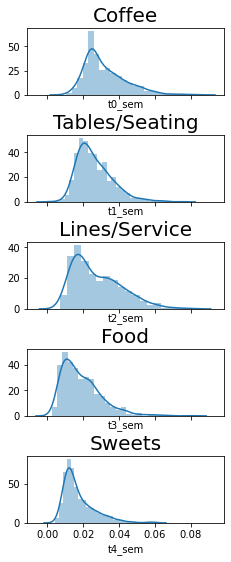

In [12]:
#Plotting the sems of each mean topic percentage estimate
#Most sems are less than 0.06
fig,ax = plt.subplots(5,1,figsize=(4,8),sharex=True)
fig.tight_layout(pad=3)
sns.distplot(avgtopicbyalias.t0_sem,ax=ax[0])
sns.distplot(avgtopicbyalias.t1_sem,ax=ax[1])
sns.distplot(avgtopicbyalias.t2_sem,ax=ax[2])
sns.distplot(avgtopicbyalias.t3_sem,ax=ax[3])
sns.distplot(avgtopicbyalias.t4_sem,ax=ax[4])
ax[0].set_title('Coffee',fontsize=20)
ax[1].set_title('Tables/Seating',fontsize=20)
ax[2].set_title('Lines/Service',fontsize=20)
ax[3].set_title('Food',fontsize=20)
ax[4].set_title('Sweets',fontsize=20)
fig.savefig('./Figures/LDA/SEM_shopaveragedldaimportance.png',bbox_inches="tight")


### Comparing LDA topic importance scores with Yelp categories

Index(['alias', 't0_mean', 't1_mean', 't2_mean', 't3_mean', 't4_mean', 'id',
       'name', 'is_closed', 'review_count', 'price', 'rating', 'transactions',
       'latitude', 'longitude', 'geometry', 'index_right', 'boro_code',
       'boro_name', 'county_fip', 'ntacode', 'ntaname', 'shape_area',
       'shape_leng', 'catlist', 'numcoffeemen', 'numreviews', 'fraccof',
       'name_top5count', 't0_std', 't1_std', 't2_std', 't3_std', 't4_std',
       't0_sem', 't1_sem', 't2_sem', 't3_sem', 't4_sem'],
      dtype='object')
(497, 39)


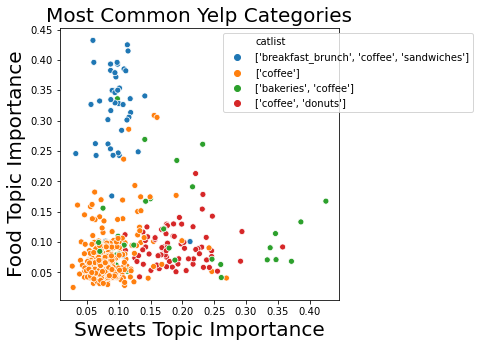

In [13]:
#Take only coffee shops that fall into the Yelp defined categories for coffee, 
#coffee+breakfast_brunch,  bakeries + coffee, coffee + donuts.  Plot on the sweets 
#vs food topic importance
avgtopicbyalias.head(10)
print(avgtopicbyalias.columns)
cattokeep = shops.catlist.value_counts().head(4).index.to_list()

avgtopicbyalias1 = avgtopicbyalias[avgtopicbyalias.catlist.isin(cattokeep)]
print(avgtopicbyalias1.shape)
fig,ax= plt.subplots(1,1,figsize=(5,5))
sns.scatterplot(x="t4_mean",y="t3_mean",hue="catlist",data=avgtopicbyalias1,ax=ax)
ax.set_xlabel('Sweets Topic Importance',fontsize=20)
ax.set_ylabel('Food Topic Importance',fontsize=20)
ax.set_title('Most Common Yelp Categories',fontsize=20)
ax.legend(bbox_to_anchor=(1.5, 1))
fig.savefig('./Figures/LDA/Mostcommoncat_foodvssweets.png',bbox_inches="tight")

### Geographic distribution of shop-averaged topic importance

In [14]:
#For each of the 5 topics, plot the topic scores on a map
m_1 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_2 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_3 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_4 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_5 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
maps = [m_1,m_2,m_3,m_4,m_5]

#add shops to the map, color coded by price


colorscale = branca.colormap.linear.YlOrRd_09.scale(0, 0.5)    

for i in range(0,len(shops)):
    for j in range(5):
        Circle(
            location=[avgtopicbyalias.iloc[i]['latitude'],avgtopicbyalias.iloc[i]['longitude']],
            radius = 20, 
            color = colorscale(avgtopicbyalias.iloc[i]['t'+str(j)+'_mean'])).add_to(maps[j])
        
for j in range(5):
    colormap1 = branca.colormap.linear.YlOrRd_09.scale(0, 0.5)
    colormap1.caption = 'Average Importance For ' + topiclabels[j]
    colormap1.add_to(maps[j])

maps[0]

In [15]:
maps[1]

In [16]:
maps[2]

In [17]:
maps[3]

In [18]:
maps[4]

Observations of the geographic distribution of average topic components for coffee shops.

1. For most coffee shops in our data set, the amount of food discussion in a reviews is pretty low. This is also the case for the coffee/tea topic.

2. Average coffee fraction is higher for most coffee shops in the data set. This topic has the highest average review fraction for most coffee shops

3. The tables/seating topic t0, and line/time topic t2 have higher review components than the food (t1) and tea/chocolate (t4) topics.  The line/time topic appears to have a hotspot of high values at the southern tip of manhattan and closer to midtown. The tables/seating topic appears to have the opposite pattern.

### Geographic distribution of shop-averaged topic importances for Starbucks only

In [24]:
#Repeating the process for only starbucks stores - controlling for what is sold
avgtopicbyalias = avgtopicbyalias[avgtopicbyalias.name=='Starbucks']
avgtopicbyalias.head(5)



,alias,t0_mean,t1_mean,t2_mean,t3_mean,t4_mean,id,name,is_closed,review_count,...,t0_std,t1_std,t2_std,t3_std,t4_std,t0_sem,t1_sem,t2_sem,t3_sem,t4_sem
549,starbucks-brooklyn-17,0.257462,0.283223,0.328603,0.043161,0.085542,mEMPhPK6dSgy5eXS-kYHLg,Starbucks,False,66,...,0.237351,0.243868,0.244199,0.058108,0.102352,0.029216,0.030018,0.030059,0.007153,0.012599
550,starbucks-brooklyn-21,0.179174,0.234515,0.448996,0.070497,0.065220,qcnoyytlFIuqlcjDXkXJiw,Starbucks,False,67,...,0.186828,0.230927,0.257790,0.082745,0.088457,0.022825,0.028212,0.031494,0.010109,0.010807
551,starbucks-brooklyn-40,0.227140,0.214795,0.457445,0.044493,0.054058,IY8HhDLbJGfHLL8GhaUicw,Starbucks,False,46,...,0.200488,0.243235,0.250815,0.056811,0.077025,0.029887,0.036259,0.037389,0.008469,0.011482
552,starbucks-brooklyn-6,0.220287,0.164671,0.476649,0.054434,0.080988,E6h-sMLmF86cuituw5zYxw,Starbucks,False,133,...,0.206557,0.186114,0.241495,0.078800,0.112676,0.020656,0.018611,0.024149,0.007880,0.011268
553,starbucks-new-york-105,0.250693,0.206226,0.395717,0.060145,0.086317,pBj0mp3gi7G1A-6K5fEQnA,Starbucks,False,33,...,0.251214,0.222163,0.247796,0.081069,0.107907,0.043731,0.038674,0.043136,0.014112,0.018784


In [29]:
#For each of the 5 topics, plot the topic scores on a map
m_1 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_2 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_3 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_4 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_5 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
maps = [m_1,m_2,m_3,m_4,m_5]

#add shops to the map, color coded by price


colorscale = branca.colormap.linear.YlOrRd_09.scale(0, 0.5)    

for i in range(0,len(avgtopicbyalias)):
    for j in range(5):
        Circle(
            location=[avgtopicbyalias.iloc[i]['latitude'],avgtopicbyalias.iloc[i]['longitude']],
            radius = 20, 
            color = colorscale(avgtopicbyalias.iloc[i]['t'+str(j)+'_mean'])).add_to(maps[j])
        
for j in range(5):
    colormap1 = branca.colormap.linear.YlOrRd_09.scale(0, 0.5)
    colormap1.caption = 'Average Importance For ' + topiclabels[j]
    colormap1.add_to(maps[j])

maps[0]

In [30]:
maps[1]

In [31]:
maps[2]

Summary of starbucks findings
1. Average topic values for starbucks are pretty homogeneous.  Dominated by lines, time, morning (t2) and tables, seating (t0) for all shops.  Average food topic % is low and average tea/chocolate topic % is low too.  The lines/time morning and seating/tables topics show similar geographic heterogeneity.  The fact that these topics show this heterogeneity despite the Starbucks product being the same indicates that geography is affecting the customer experience.  Perhaps there are longer lines in the places where topic t2 is stronger, and more seating/tables where topic t0 is stronger.

Average topic proportions by district

In [35]:
avgtopicbyalias = merged.groupby('alias')[['t0','t1','t2','t3','t4']].mean()
avgtopicbyalias.reset_index()
avgtopicbyalias = pd.merge(avgtopicbyalias,shops,how='inner',on = ['alias'])
avgtopicbyalias.head(1)

,alias,t0,t1,t2,t3,t4,id,name,is_closed,review_count,...,county_fip,ntacode,ntaname,shape_area,shape_leng,catlist,numcoffeemen,numreviews,fraccof,name_top5count
0,11th-street-cafe-new-york,0.312584,0.143005,0.140929,0.332356,0.069849,PW3ty0qUsqcLHKfFlhY-7A,11th Street Cafe,False,145,...,61,MN23,West Village,2.497065e+07,28621.650991,"['breakfast_brunch', 'coffee', 'sandwiches']",62.0,100,0.62,other


### Plotting the average topic importance (across shops) for each neighborhood tabulation area

In [36]:
avgtopicbynta = avgtopicbyalias.groupby('ntacode')[['t0','t1','t2','t3','t4']].mean()
numshopsbynta = avgtopicbyalias.groupby('ntacode')['alias'].count()
numshopsbynta.head(1)

ntacode
BK09    7
Name: alias, dtype: int64

In [37]:
avgtopicbynta['count'] = numshopsbynta
avgtopicbynta.reset_index(inplace=True)
print(avgtopicbynta)
avgtopicbynta = avgtopicbynta[avgtopicbynta['count']>10]
avgtopicbynta

   ntacode        t0        t1        t2        t3        t4  count
0     BK09  0.355955  0.198694  0.196248  0.127962  0.119369      7
1     BK38  0.345383  0.219105  0.255782  0.077185  0.100369      8
2     BK76  0.189931  0.151101  0.105482  0.087285  0.463638      1
3     MN09  0.330212  0.217120  0.152203  0.186246  0.112658     13
4     MN11  0.460707  0.151264  0.196434  0.096025  0.094506      2
5     MN12  0.314864  0.200399  0.221426  0.127503  0.133905     25
6     MN13  0.359309  0.205627  0.215517  0.111803  0.105694     72
7     MN14  0.333186  0.198620  0.241108  0.116327  0.108931     19
8     MN15  0.344770  0.180173  0.253546  0.099781  0.119904     30
9     MN17  0.301724  0.175100  0.263250  0.146055  0.112110    148
10    MN19  0.308669  0.164107  0.242702  0.156914  0.125589     55
11    MN20  0.289787  0.182377  0.281860  0.140240  0.103740     30
12    MN21  0.326118  0.175688  0.256488  0.115893  0.123852     15
13    MN22  0.356184  0.213788  0.169568  0.1488

,ntacode,t0,t1,t2,t3,t4,count
3,MN09,0.330212,0.217120,0.152203,0.186246,0.112658,13
5,MN12,0.314864,0.200399,0.221426,0.127503,0.133905,25
6,MN13,0.359309,0.205627,0.215517,0.111803,0.105694,72
7,MN14,0.333186,0.198620,0.241108,0.116327,0.108931,19
8,MN15,0.344770,0.180173,0.253546,0.099781,0.119904,30
9,MN17,0.301724,0.175100,0.263250,0.146055,0.112110,148
10,MN19,0.308669,0.164107,0.242702,0.156914,0.125589,55
11,MN20,0.289787,0.182377,0.281860,0.140240,0.103740,30
12,MN21,0.326118,0.175688,0.256488,0.115893,0.123852,15
13,MN22,0.356184,0.213788,0.169568,0.148897,0.108934,32


In [38]:
#Creating Chloropeth maps to show average lda topic score across coffee shops by nta region

districts_full = gpd.read_file('./NeighborhoodTabulationAreas/geo_export_635227ce-99b9-4575-b120-dba900c98200.shp')
districts = districts_full[["ntacode", "geometry"]].set_index("ntacode")
districts.head()

# Number of crimes in each police district
avgtopicbynta = avgtopicbynta.set_index("ntacode")
print(avgtopicbynta)




               t0        t1        t2        t3        t4  count
ntacode                                                         
MN09     0.330212  0.217120  0.152203  0.186246  0.112658     13
MN12     0.314864  0.200399  0.221426  0.127503  0.133905     25
MN13     0.359309  0.205627  0.215517  0.111803  0.105694     72
MN14     0.333186  0.198620  0.241108  0.116327  0.108931     19
MN15     0.344770  0.180173  0.253546  0.099781  0.119904     30
MN17     0.301724  0.175100  0.263250  0.146055  0.112110    148
MN19     0.308669  0.164107  0.242702  0.156914  0.125589     55
MN20     0.289787  0.182377  0.281860  0.140240  0.103740     30
MN21     0.326118  0.175688  0.256488  0.115893  0.123852     15
MN22     0.356184  0.213788  0.169568  0.148897  0.108934     32
MN23     0.340039  0.218846  0.184069  0.152472  0.102224     68
MN24     0.352996  0.198770  0.205425  0.114847  0.125881     80
MN25     0.356363  0.160395  0.259840  0.103943  0.117527     53
MN27     0.352681  0.2649

In [39]:
m_1 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_2 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_3 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_4 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_5 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)
m_6 = folium.Map(location=[40.74,-73.98],tiles='cartodbpositron',zoom_start=13, width = 500, height=350)

maps = [m_1,m_2,m_3,m_4,m_5,m_6]

for i in range(5):
    Choropleth(geo_data=districts.__geo_interface__, 
           data=avgtopicbynta['t' + str(i)], 
           key_on="feature.id", 
           fill_color='YlGnBu', 
           legend_name='Average Importance For ' + topiclabels[i] + ' Topic'
          ).add_to(maps[i])    
    

Choropleth(geo_data=districts.__geo_interface__, 
           data=avgtopicbynta['count'], 
           key_on="feature.id", 
           fill_color='YlGnBu', 
           legend_name='Number of coffee shops in NTA district'
          ).add_to(maps[5])

# Display the maps. Coffee
maps[0]


In [40]:
maps[1]

In [41]:
maps[2]

In [42]:
maps[3]

In [43]:
maps[4]

In [44]:
maps[5]